# Exploratory data analysis

## Description of the dataset

This UCI dataset contains information on default payments, demographic factors, credit data, history of payment, and bill statements of credit card clients in Taiwan from April 2005 to September 2005.

The dataset is composed by 24 variables in total. The first variables contains information about the user personal information:

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns 
import plotly.express as px
from visualization import *
warnings.simplefilter("ignore")
from xgboost import XGBClassifier

In [2]:
pd.set_option('display.max_row', 111)
pd.set_option('display.max_column', 111)

In [3]:
df = pd.read_excel("default of credit card clients.xls")
df.head()

,Unnamed: 0,X1,X2,X3,X4,X5,X6,X7,X8,X9,X10,X11,X12,X13,X14,X15,X16,X17,X18,X19,X20,X21,X22,X23,Y
0,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
1,1,20000,2,2,1,24,2,2,-1,-1,-2,-2,3913,3102,689,0,0,0,0,689,0,0,0,0,1
2,2,120000,2,2,2,26,-1,2,0,0,0,2,2682,1725,2682,3272,3455,3261,0,1000,1000,1000,0,2000,1
3,3,90000,2,2,2,34,0,0,0,0,0,0,29239,14027,13559,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
4,4,50000,2,2,1,37,0,0,0,0,0,0,46990,48233,49291,28314,28959,29547,2000,2019,1200,1100,1069,1000,0


In [4]:
df.shape

(30001, 25)

In [5]:
data=df.copy()
data.columns

Index(['Unnamed: 0', 'X1', 'X2', 'X3', 'X4', 'X5', 'X6', 'X7', 'X8', 'X9',
       'X10', 'X11', 'X12', 'X13', 'X14', 'X15', 'X16', 'X17', 'X18', 'X19',
       'X20', 'X21', 'X22', 'X23', 'Y'],
      dtype='object')

In [6]:
data.columns=data.iloc[0]
data=data.drop(0)

In [7]:
data.columns

Index(['ID', 'LIMIT_BAL', 'SEX', 'EDUCATION', 'MARRIAGE', 'AGE', 'PAY_0',
       'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6', 'BILL_AMT1', 'BILL_AMT2',
       'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1',
       'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6',
       'default payment next month'],
      dtype='object', name=0)

In [8]:
data.head()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
1,1,20000,2,2,1,24,2,2,-1,-1,-2,-2,3913,3102,689,0,0,0,0,689,0,0,0,0,1
2,2,120000,2,2,2,26,-1,2,0,0,0,2,2682,1725,2682,3272,3455,3261,0,1000,1000,1000,0,2000,1
3,3,90000,2,2,2,34,0,0,0,0,0,0,29239,14027,13559,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
4,4,50000,2,2,1,37,0,0,0,0,0,0,46990,48233,49291,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
5,5,50000,1,2,1,57,-1,0,-1,0,0,0,8617,5670,35835,20940,19146,19131,2000,36681,10000,9000,689,679,0


In [9]:
data = data.drop(axis=1, columns='ID')
data.head()

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
1,20000,2,2,1,24,2,2,-1,-1,-2,-2,3913,3102,689,0,0,0,0,689,0,0,0,0,1
2,120000,2,2,2,26,-1,2,0,0,0,2,2682,1725,2682,3272,3455,3261,0,1000,1000,1000,0,2000,1
3,90000,2,2,2,34,0,0,0,0,0,0,29239,14027,13559,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
4,50000,2,2,1,37,0,0,0,0,0,0,46990,48233,49291,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
5,50000,1,2,1,57,-1,0,-1,0,0,0,8617,5670,35835,20940,19146,19131,2000,36681,10000,9000,689,679,0


In [10]:
data.shape

(30000, 24)

In [11]:
data.isna().values.any() 

False

In [12]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 30000 entries, 1 to 30000
Data columns (total 24 columns):
 #   Column                      Non-Null Count  Dtype 
---  ------                      --------------  ----- 
 0   LIMIT_BAL                   30000 non-null  object
 1   SEX                         30000 non-null  object
 2   EDUCATION                   30000 non-null  object
 3   MARRIAGE                    30000 non-null  object
 4   AGE                         30000 non-null  object
 5   PAY_0                       30000 non-null  object
 6   PAY_2                       30000 non-null  object
 7   PAY_3                       30000 non-null  object
 8   PAY_4                       30000 non-null  object
 9   PAY_5                       30000 non-null  object
 10  PAY_6                       30000 non-null  object
 11  BILL_AMT1                   30000 non-null  object
 12  BILL_AMT2                   30000 non-null  object
 13  BILL_AMT3                   30000 non-null  ob

In [13]:
data=data.apply(pd.to_numeric)

In [14]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 30000 entries, 1 to 30000
Data columns (total 24 columns):
 #   Column                      Non-Null Count  Dtype
---  ------                      --------------  -----
 0   LIMIT_BAL                   30000 non-null  int64
 1   SEX                         30000 non-null  int64
 2   EDUCATION                   30000 non-null  int64
 3   MARRIAGE                    30000 non-null  int64
 4   AGE                         30000 non-null  int64
 5   PAY_0                       30000 non-null  int64
 6   PAY_2                       30000 non-null  int64
 7   PAY_3                       30000 non-null  int64
 8   PAY_4                       30000 non-null  int64
 9   PAY_5                       30000 non-null  int64
 10  PAY_6                       30000 non-null  int64
 11  BILL_AMT1                   30000 non-null  int64
 12  BILL_AMT2                   30000 non-null  int64
 13  BILL_AMT3                   30000 non-null  int64
 14  BILL_A

In [15]:
# wrong column name PAY_0 setted to PAY_1
data.rename(columns={'PAY_0':'PAY_1'}, inplace=True)
data.head()

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
1,20000,2,2,1,24,2,2,-1,-1,-2,-2,3913,3102,689,0,0,0,0,689,0,0,0,0,1
2,120000,2,2,2,26,-1,2,0,0,0,2,2682,1725,2682,3272,3455,3261,0,1000,1000,1000,0,2000,1
3,90000,2,2,2,34,0,0,0,0,0,0,29239,14027,13559,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
4,50000,2,2,1,37,0,0,0,0,0,0,46990,48233,49291,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
5,50000,1,2,1,57,-1,0,-1,0,0,0,8617,5670,35835,20940,19146,19131,2000,36681,10000,9000,689,679,0


In [16]:
print(data.groupby('default payment next month').size())
#we can conclude that there is a high imbalance between the 2 classes

default payment next month
0    23364
1     6636
dtype: int64


In [17]:
data = data[~data.duplicated(keep="first") ]
data.shape

(29965, 24)

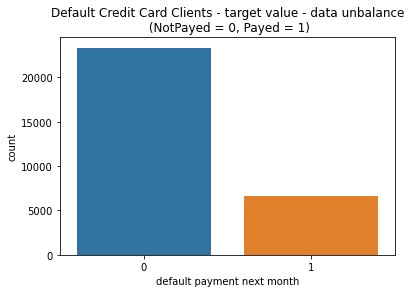

In [18]:
# Graphiquement
import seaborn as sns 
sns.countplot(x=data['default payment next month'] , label='Count')
plt.title('Default Credit Card Clients - target value - data unbalance\n (NotPayed = 0, Payed = 1)')
plt.show()

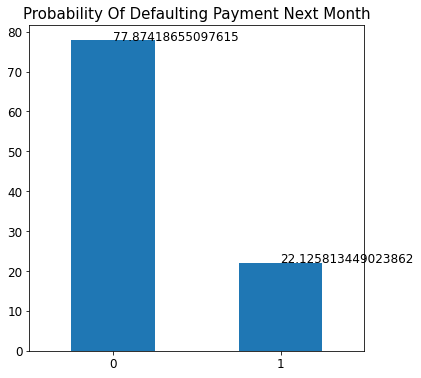

In [19]:
#Test probability of default risk next month in %

Payment_count = (data['default payment next month'].value_counts(normalize=True)*100)
Payment_count.plot.bar(figsize=(6,6))
plt.xticks(fontsize=12, rotation=0)
plt.yticks(fontsize=12)
plt.title("Probability Of Defaulting Payment Next Month", fontsize=15)
for x,y in zip([0,1],Payment_count):
    plt.text(x,y,y,fontsize=12)
plt.show()

<AxesSubplot:ylabel='Density'>

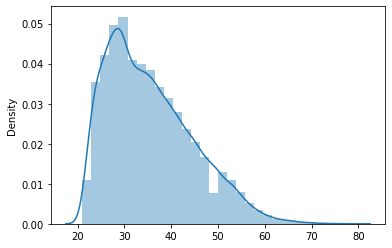

In [20]:
sns.distplot(x=data['AGE'],kde=True,bins=30)

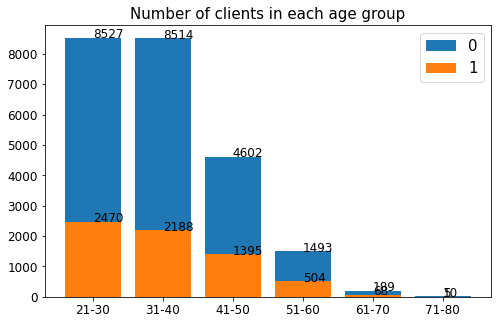

In [21]:
bins = [20,30,40,50,60,70,80]
names = ['21-30','31-40','41-50','51-60','61-70','71-80']
dat=data.copy()
dat['AGE_BIN'] = pd.cut(x=dat.AGE, bins=bins, labels=names, right=True)

age_cnt = dat.AGE_BIN.value_counts()
age_0 = (dat.AGE_BIN[dat['default payment next month'] == 0].value_counts())
age_1 = (dat.AGE_BIN[dat['default payment next month'] == 1].value_counts())

plt.subplots(figsize=(8,5))
plt.bar(age_0.index, age_0.values, label='0')
plt.bar(age_1.index, age_1.values, label='1')
for x,y in zip(names,age_0):
    plt.text(x,y,y,fontsize=12)
for x,y in zip(names,age_1):
    plt.text(x,y,y,fontsize=12)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.title("Number of clients in each age group", fontsize=15)
plt.legend(loc='upper right', fontsize=15)
plt.show()

we can conclude if the age of the customer increases the prop to have a default payment decrease

In [22]:
gender = data.groupby(['SEX','default payment next month']).size().unstack(1).T
gender

SEX,1,2
default payment next month,,
0,9005,14330
1,2869,3761


<AxesSubplot:>

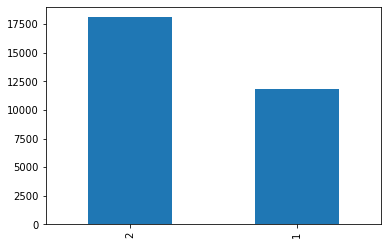

In [23]:
data['SEX'].value_counts().plot.bar()

<AxesSubplot:xlabel='default payment next month'>

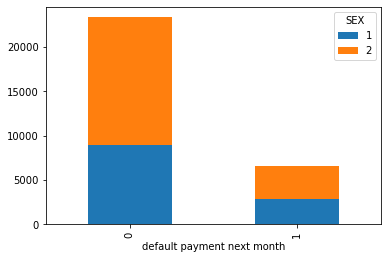

In [24]:
gender.plot(kind='bar', stacked = True)


we can conclude that female customers who will not pay next month are more than male customers

# Data cleaning and preprocessing¶

In [25]:
data.describe()

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
count,29965.000000,29965.000000,29965.000000,29965.000000,29965.000000,29965.000000,29965.000000,29965.000000,29965.000000,29965.000000,29965.000000,29965.000000,29965.000000,2.996500e+04,29965.000000,29965.000000,29965.000000,29965.000000,2.996500e+04,29965.000000,29965.000000,29965.000000,29965.000000,29965.000000
mean,167442.005006,1.603738,1.853629,1.551877,35.487969,-0.016753,-0.131854,-0.164392,-0.218922,-0.264509,-0.289438,51283.009778,49236.366294,4.706792e+04,43313.329885,40358.334390,38917.012281,5670.099316,5.927983e+03,5231.688837,4831.617454,4804.897047,5221.498014,0.221258
std,129760.135222,0.489128,0.790411,0.521997,9.219459,1.123492,1.196322,1.195878,1.168175,1.132220,1.149090,73658.132403,71195.567392,6.937135e+04,64353.514373,60817.130623,59574.147742,16571.849467,2.305346e+04,17616.361124,15674.464538,15286.372298,17786.976864,0.415101
min,10000.000000,1.000000,0.000000,0.000000,21.000000,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000,-165580.000000,-69777.000000,-1.572640e+05,-170000.000000,-81334.000000,-339603.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000
25%,50000.000000,1.000000,1.000000,1.000000,28.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,3595.000000,3010.000000,2.711000e+03,2360.000000,1787.000000,1262.000000,1000.000000,8.500000e+02,390.000000,300.000000,261.000000,131.000000,0.000000
50%,140000.000000,2.000000,2.000000,2.000000,34.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,22438.000000,21295.000000,2.013500e+04,19081.000000,18130.000000,17124.000000,2102.000000,2.010000e+03,1804.000000,1500.000000,1500.000000,1500.000000,0.000000
75%,240000.000000,2.000000,2.000000,2.000000,41.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,67260.000000,64109.000000,6.020100e+04,54601.000000,50247.000000,49252.000000,5008.000000,5.000000e+03,4512.000000,4016.000000,4042.000000,4000.000000,0.000000
max,1000000.000000,2.000000,6.000000,3.000000,79.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,964511.000000,983931.000000,1.664089e+06,891586.000000,927171.000000,961664.000000,873552.000000,1.684259e+06,896040.000000,621000.000000,426529.000000,528666.000000,1.000000


In [26]:
features_Nb0 =data.iloc[:,:-1].isin([0]).sum(axis=0)
features_Nb0

0
LIMIT_BAL        0
SEX              0
EDUCATION       14
MARRIAGE        54
AGE              0
PAY_1        14737
PAY_2        15730
PAY_3        15764
PAY_4        16455
PAY_5        16947
PAY_6        16286
BILL_AMT1     1978
BILL_AMT2     2476
BILL_AMT3     2840
BILL_AMT4     3165
BILL_AMT5     3476
BILL_AMT6     3990
PAY_AMT1      5218
PAY_AMT2      5365
PAY_AMT3      5937
PAY_AMT4      6377
PAY_AMT5      6672
PAY_AMT6      7142
dtype: int64

Text(0.5, 1.0, 'Number of rows for each EDUCATION category')

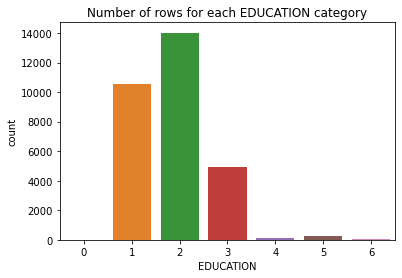

In [27]:
sns.countplot(x=data['EDUCATION'] , label='Count')
plt.title('Number of rows for each EDUCATION category')

In [28]:
data['EDUCATION'].value_counts()

2    14019
1    10563
3     4915
5      280
4      123
6       51
0       14
Name: EDUCATION, dtype: int64

In [29]:
data['EDUCATION']=np.where(data['EDUCATION'] == 5, 4, data['EDUCATION'])
data['EDUCATION']=np.where(data['EDUCATION'] == 6, 4, data['EDUCATION'])
data['EDUCATION']=np.where(data['EDUCATION'] == 0, 4, data['EDUCATION'])
data['EDUCATION'].unique()

array([2, 1, 3, 4], dtype=int64)

Text(0.5, 1.0, 'Number of rows for each EDUCATION category with pre-processing')

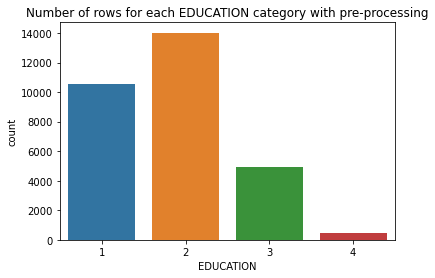

In [30]:

sns.countplot(x=data['EDUCATION'] , label='Count')
plt.title('Number of rows for each EDUCATION category with pre-processing')

In [31]:
data['EDUCATION'].value_counts()

2    14019
1    10563
3     4915
4      468
Name: EDUCATION, dtype: int64

<AxesSubplot:xlabel='EDUCATION', ylabel='count'>

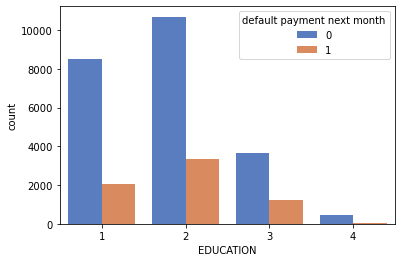

In [32]:
sns.countplot(x='EDUCATION',data=data,hue="default payment next month", palette="muted")

class 2 customers have a higher probability of not paying their credits than other customers

Text(0.5, 1.0, 'Number of rows for each MARRIAGE category')

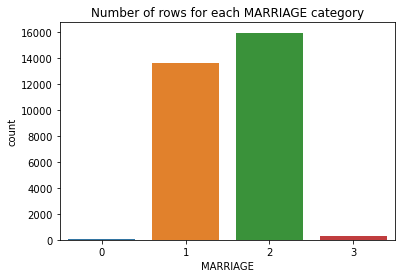

In [33]:
sns.countplot(x=data['MARRIAGE'] , label='Count')
plt.title('Number of rows for each MARRIAGE category')

In [34]:
data['MARRIAGE'].value_counts()

2    15945
1    13643
3      323
0       54
Name: MARRIAGE, dtype: int64

In [35]:
data['MARRIAGE']=np.where(data['MARRIAGE'] == 0, 3, data['MARRIAGE'])
data['MARRIAGE'].unique()

array([1, 2, 3], dtype=int64)

Text(0.5, 1.0, 'Number of rows for each MARRIAGE category with pre-processing')

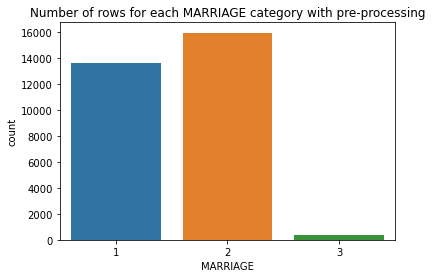

In [36]:
sns.countplot(x=data['MARRIAGE'] , label='Count')
plt.title('Number of rows for each MARRIAGE category with pre-processing')

In [37]:
data['MARRIAGE'].value_counts()

2    15945
1    13643
3      377
Name: MARRIAGE, dtype: int64

<AxesSubplot:xlabel='MARRIAGE', ylabel='count'>

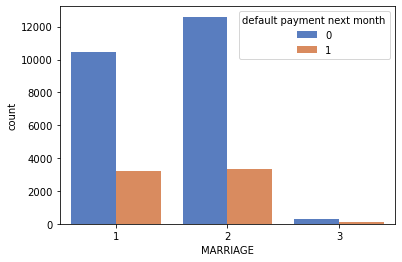

In [38]:
sns.countplot(x='MARRIAGE',data=data,hue="default payment next month", palette="muted")

In [39]:
data[['PAY_' + str(n) for n in range(1, 7)]] += 1
data[['PAY_' + str(n) for n in range(1, 7)]].describe()

,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6
count,29965.000000,29965.000000,29965.000000,29965.000000,29965.000000,29965.000000
mean,0.983247,0.868146,0.835608,0.781078,0.735491,0.710562
std,1.123492,1.196322,1.195878,1.168175,1.132220,1.149090
min,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
max,9.000000,9.000000,9.000000,9.000000,9.000000,9.000000


In [40]:
data['PAY_1'].value_counts()

 1    14737
 0     5682
 2     3667
-1     2750
 3     2666
 4      322
 5       76
 6       26
 9       19
 7       11
 8        9
Name: PAY_1, dtype: int64

# Anomaly detection

## Q-Q plot

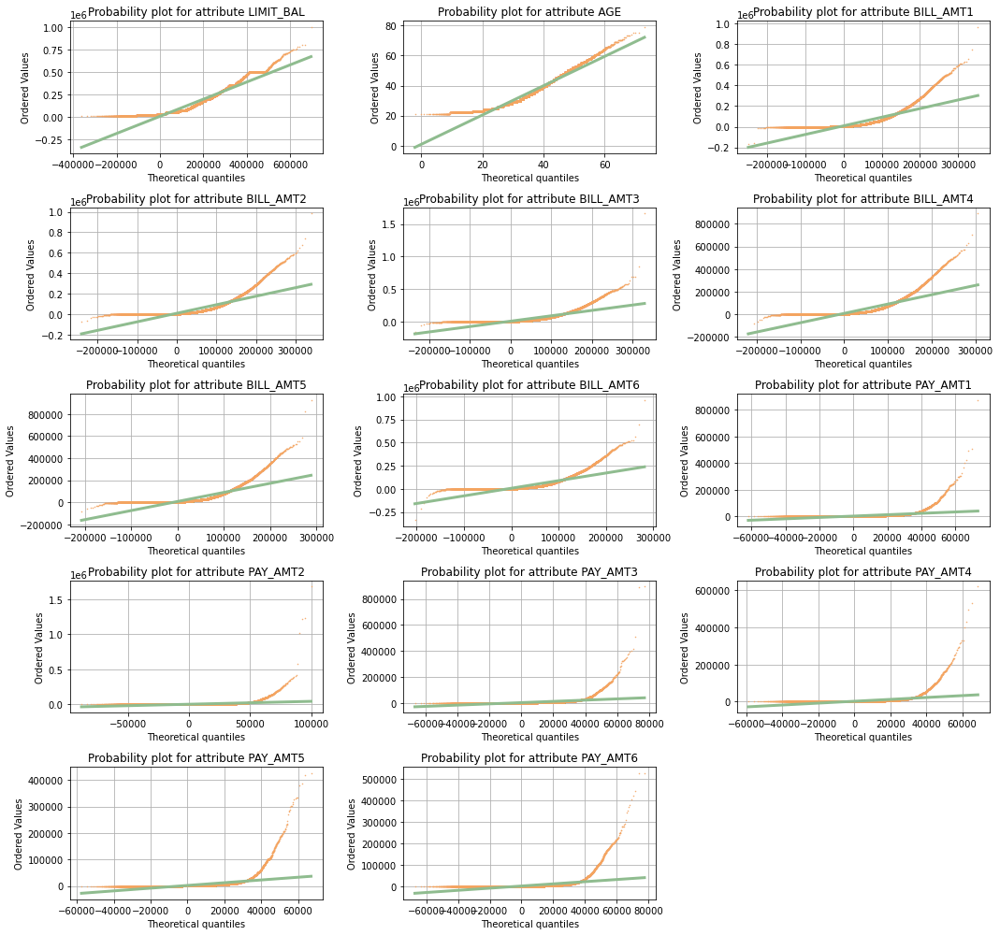

In [41]:
from scipy import stats

figs, axs= plt.subplots(5, 3, figsize=(15, 14))

i, j = 0, 0
d1 = ['BILL_AMT' + str(i) for i in range(1, 7)]
d2 = ['PAY_AMT' + str(i) for i in range(1, 7)]
d =  ['LIMIT_BAL', 'AGE'] + d1 + d2
for attribute in d:
    if j == 3:
        j = 0
        i = i+1
    stats.probplot(
        data[attribute], 
        dist="norm", 
        sparams = (data[attribute].mean(), data[attribute].std()),
        plot=axs[i, j]
    )
    
    axs[i, j].get_lines()[0].set_marker('.')
    axs[i, j].get_lines()[0].set_color('sandybrown')
    axs[i, j].get_lines()[0].set_markersize(1.0)
    axs[i, j].set_title('Probability plot for attribute ' + attribute)
    axs[i, j].grid()
    axs[i, j].get_lines()[1].set_linewidth(3.0)
    axs[i, j].get_lines()[1].set_color('darkseagreen')
    j = j+1
    
figs.tight_layout()
axs[4, 2].set_visible(False)
plt.show()

# Boxplot

In [42]:
def detectOutliers(X, outlierConstant=1.5):
    a = np.array(X)
    upper_quartile = np.percentile(a, 75)
    lower_quartile = np.percentile(a, 25)
    IQR = (upper_quartile - lower_quartile) * outlierConstant
    quartileSet = (lower_quartile - IQR, upper_quartile + IQR)
    resultList = []
    for y in a.tolist():
      if y >= quartileSet[0] and y <= quartileSet[1]:
          resultList.append(1)
      else:
          resultList.append(-1)
    return np.array(resultList)

In [43]:
d1 = ['BILL_AMT' + str(i) for i in range(1, 7)]
d2 = ['PAY_AMT' + str(i) for i in range(1, 7)]
d = ['LIMIT_BAL', 'AGE'] + d1 + d2


data1 = pd.concat([data['default payment next month'], data[d]], axis=1)
data1 = pd.melt(
    data1,
    id_vars="default payment next month",
    var_name = "features",
    value_name = "value",
)

fig = px.box(
    data1,
    x = "features",
    y = "value",
    color = "default payment next month",
    color_discrete_sequence=px.colors.qualitative.Set2,
)
fig.update_layout(
    xaxis_title= "Features",
    yaxis_title= "",
    title='Boxplot for the different attributes'
)
fig.show()

In [44]:
box_outliers = detectOutliers(data['LIMIT_BAL'] )

for i in range(1,7):
  #plot_boxplot('BILL_AMT' + str(i), X_train_val)
  new_outliers = detectOutliers(data['BILL_AMT' + str(i)] )
  mask = np.array((box_outliers == -1)&(new_outliers == -1))
  box_outliers[mask == True] = -1
  box_outliers[mask == False] = 1
  


for i in range(1,7):
  #plot_boxplot('PAY_AMT' + str(i), X_train_val)
  new_outliers = detectOutliers(data['PAY_AMT' + str(i)] )
  mask = np.array((box_outliers == -1)&(new_outliers == -1))
  box_outliers[mask == True] = -1
  box_outliers[mask == False] = 1

## Isolation forests

In [45]:
from sklearn.ensemble import IsolationForest
x=data.drop('default payment next month', axis=1)
isolation_forest = IsolationForest()
is_outliers = isolation_forest.fit_predict(x)
score_sample =isolation_forest.score_samples(x)
offset = isolation_forest.offset_
title = "Score of each data point in Isolation forest"
x_position_outlier_ann = 487
y_position_outlier_ann = -0.57

plot_score_outliers(score_sample, offset, title, x_position_outlier_ann, y_position_outlier_ann)

# Local Outlier Factor

In [46]:
from sklearn.neighbors import LocalOutlierFactor
lof = LocalOutlierFactor(n_neighbors=200)
lof_outliers = lof.fit_predict(x)
score_sample = lof.negative_outlier_factor_
offset = lof.offset_

title = "Score of each data point in Local Outlier Factor"
x_position_outlier_ann = 896
y_position_outlier_ann = -1.62

plot_score_outliers(score_sample, offset, title, x_position_outlier_ann, y_position_outlier_ann)

In [47]:
num_is_outliers = len(np.where(is_outliers == -1)[0])
num_lof_outliers = len(np.where(lof_outliers == -1)[0])
print('Outliers with Isolation Forest:',num_is_outliers)
print('Outliers with LOF:' ,num_lof_outliers)

mask = (is_outliers == -1)&(lof_outliers == -1)

common_outlier = np.sum(mask)
print('outliers in common:',common_outlier)

data.drop(data[mask].index, axis=0, inplace=True)

Outliers with Isolation Forest: 2301
Outliers with LOF: 7307
outliers in common: 1091


In [48]:
data.shape


(28874, 24)

In [49]:
data['PAY_1'].value_counts()


 1    14350
 0     5395
 2     3591
 3     2605
-1     2503
 4      312
 5       70
 6       19
 9       13
 7        8
 8        8
Name: PAY_1, dtype: int64

In [50]:
def onehot_encode(data , column_dict):
    data = data.copy()
    for col ,prefix in column_dict.items():
        dummies = pd.get_dummies(data[col], prefix = prefix )
        data = pd.concat([data , dummies] , axis = 1)
        data = data.drop(col , axis = 1)
    return data

In [51]:
data = onehot_encode(data , {"EDUCATION" : "EDU_TYPE"})

In [52]:
data = onehot_encode(data , {"MARRIAGE" : "Mar_TYPE"})

In [53]:
data = onehot_encode(data , {"SEX" : "SEX_TYPE"})

In [54]:
data.head()

,LIMIT_BAL,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month,EDU_TYPE_1,EDU_TYPE_2,EDU_TYPE_3,EDU_TYPE_4,Mar_TYPE_1,Mar_TYPE_2,Mar_TYPE_3,SEX_TYPE_1,SEX_TYPE_2
1,20000,24,3,3,0,0,-1,-1,3913,3102,689,0,0,0,0,689,0,0,0,0,1,0,1,0,0,1,0,0,0,1
2,120000,26,0,3,1,1,1,3,2682,1725,2682,3272,3455,3261,0,1000,1000,1000,0,2000,1,0,1,0,0,0,1,0,0,1
3,90000,34,1,1,1,1,1,1,29239,14027,13559,14331,14948,15549,1518,1500,1000,1000,1000,5000,0,0,1,0,0,0,1,0,0,1
4,50000,37,1,1,1,1,1,1,46990,48233,49291,28314,28959,29547,2000,2019,1200,1100,1069,1000,0,0,1,0,0,1,0,0,0,1
5,50000,57,0,1,0,1,1,1,8617,5670,35835,20940,19146,19131,2000,36681,10000,9000,689,679,0,0,1,0,0,1,0,0,1,0


In [55]:
permut_1 = data[["LIMIT_BAL"]]
permut_2 = data[["SEX_TYPE_1","SEX_TYPE_2","EDU_TYPE_1","EDU_TYPE_2","EDU_TYPE_3","EDU_TYPE_4","Mar_TYPE_1","Mar_TYPE_2","Mar_TYPE_3"]]
data = pd.concat([permut_2,data.drop(["LIMIT_BAL" ,"SEX_TYPE_1","SEX_TYPE_2","EDU_TYPE_1","EDU_TYPE_2","EDU_TYPE_3","EDU_TYPE_4","Mar_TYPE_1","Mar_TYPE_2","Mar_TYPE_3"],axis = 1)],axis = 1)

In [56]:
data = pd.concat([permut_1 , data] ,axis = 1) 
data

,LIMIT_BAL,SEX_TYPE_1,SEX_TYPE_2,EDU_TYPE_1,EDU_TYPE_2,EDU_TYPE_3,EDU_TYPE_4,Mar_TYPE_1,Mar_TYPE_2,Mar_TYPE_3,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
1,20000,0,1,0,1,0,0,1,0,0,24,3,3,0,0,-1,-1,3913,3102,689,0,0,0,0,689,0,0,0,0,1
2,120000,0,1,0,1,0,0,0,1,0,26,0,3,1,1,1,3,2682,1725,2682,3272,3455,3261,0,1000,1000,1000,0,2000,1
3,90000,0,1,0,1,0,0,0,1,0,34,1,1,1,1,1,1,29239,14027,13559,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
4,50000,0,1,0,1,0,0,1,0,0,37,1,1,1,1,1,1,46990,48233,49291,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
5,50000,1,0,0,1,0,0,1,0,0,57,0,1,0,1,1,1,8617,5670,35835,20940,19146,19131,2000,36681,10000,9000,689,679,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29996,220000,1,0,0,0,1,0,1,0,0,39,1,1,1,1,1,1,188948,192815,208365,88004,31237,15980,8500,20000,5003,3047,5000,1000,0
29997,150000,1,0,0,0,1,0,0,1,0,43,0,0,0,0,1,1,1683,1828,3502,8979,5190,0,1837,3526,8998,129,0,0,0
29998,30000,1,0,0,1,0,0,0,1,0,37,5,4,3,0,1,1,3565,3356,2758,20878,20582,19357,0,0,22000,4200,2000,3100,1
29999,80000,1,0,0,0,1,0,1,0,0,41,2,0,1,1,1,0,-1645,78379,76304,52774,11855,48944,85900,3409,1178,1926,52964,1804,1


In [57]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
data['LIMIT_BAL'] = scaler.fit_transform(data['LIMIT_BAL'].values.reshape(-1, 1))
data['AGE'] = scaler.fit_transform(data['AGE'].values.reshape(-1, 1))


for i in range(1,7):
    scaler = MinMaxScaler()
    data['BILL_AMT' + str(i)] = scaler.fit_transform(data['BILL_AMT' + str(i)].values.reshape(-1, 1))

for i in range(1,7):
    scaler = MinMaxScaler()
    data['PAY_AMT' + str(i)] = scaler.fit_transform(data['PAY_AMT' + str(i)].values.reshape(-1, 1))
    
for i in range(1,7):
    scaler = MinMaxScaler()
    data['PAY_' + str(i)] = scaler.fit_transform(data['PAY_' + str(i)].values.reshape(-1, 1))

In [58]:
data.describe()

,LIMIT_BAL,SEX_TYPE_1,SEX_TYPE_2,EDU_TYPE_1,EDU_TYPE_2,EDU_TYPE_3,EDU_TYPE_4,Mar_TYPE_1,Mar_TYPE_2,Mar_TYPE_3,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
count,28874.000000,28874.000000,28874.000000,28874.000000,28874.000000,28874.000000,28874.000000,28874.000000,28874.000000,28874.000000,28874.000000,28874.000000,28874.000000,28874.000000,28874.000000,28874.000000,28874.000000,28874.000000,28874.000000,28874.000000,28874.000000,28874.000000,28874.000000,28874.000000,28874.000000,28874.000000,28874.000000,28874.000000,28874.000000,28874.000000
mean,0.191535,0.392776,0.607224,0.347960,0.472951,0.164646,0.014442,0.452795,0.535153,0.012052,0.247881,0.199719,0.188097,0.184713,0.179050,0.174268,0.171632,0.104927,0.181373,0.160417,0.174156,0.153122,0.433910,0.022922,0.012856,0.017390,0.020095,0.013364,0.010095,0.224354
std,0.158234,0.488376,0.488376,0.476332,0.499276,0.370868,0.119306,0.497775,0.498771,0.109122,0.158827,0.110622,0.118835,0.118741,0.116161,0.112795,0.114663,0.118568,0.102824,0.112562,0.097868,0.087161,0.064177,0.048110,0.028074,0.036622,0.047948,0.034498,0.029739,0.417163
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.050633,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.120690,0.100000,0.100000,0.100000,0.100000,0.100000,0.100000,0.026027,0.113075,0.086265,0.110809,0.097180,0.392951,0.004778,0.002290,0.001751,0.001437,0.000726,0.000154,0.000000
50%,0.151899,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.224138,0.200000,0.200000,0.200000,0.200000,0.200000,0.200000,0.057892,0.140521,0.116633,0.137818,0.121753,0.410562,0.010254,0.005806,0.007722,0.007970,0.005280,0.003519,0.000000
75%,0.278481,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,1.000000,1.000000,0.000000,0.344828,0.200000,0.200000,0.200000,0.200000,0.200000,0.200000,0.132824,0.204102,0.184070,0.190912,0.169599,0.446569,0.025146,0.014283,0.018406,0.021061,0.013905,0.009497,0.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [59]:
from sklearn.model_selection import train_test_split

Y=data.iloc[:,-1]
X=data.drop("default payment next month",axis=1)
X_train,X_test,Y_train,Y_test=train_test_split(X,Y,test_size=0.2,random_state=0)

In order to identify if there might be possible relationships among non categorical variables we plot the scatter matrix. This matrix contains, for each combination of the numeric variables, a small scatterplot that displays the distribution of data points among the two variables considered, separated by the two classes.

The limit of this visualization is that each scatter plot in the matrix visualizes the relationship between a pair of variables only and it is not able to convert the strenght of a relationship in a quantitative form

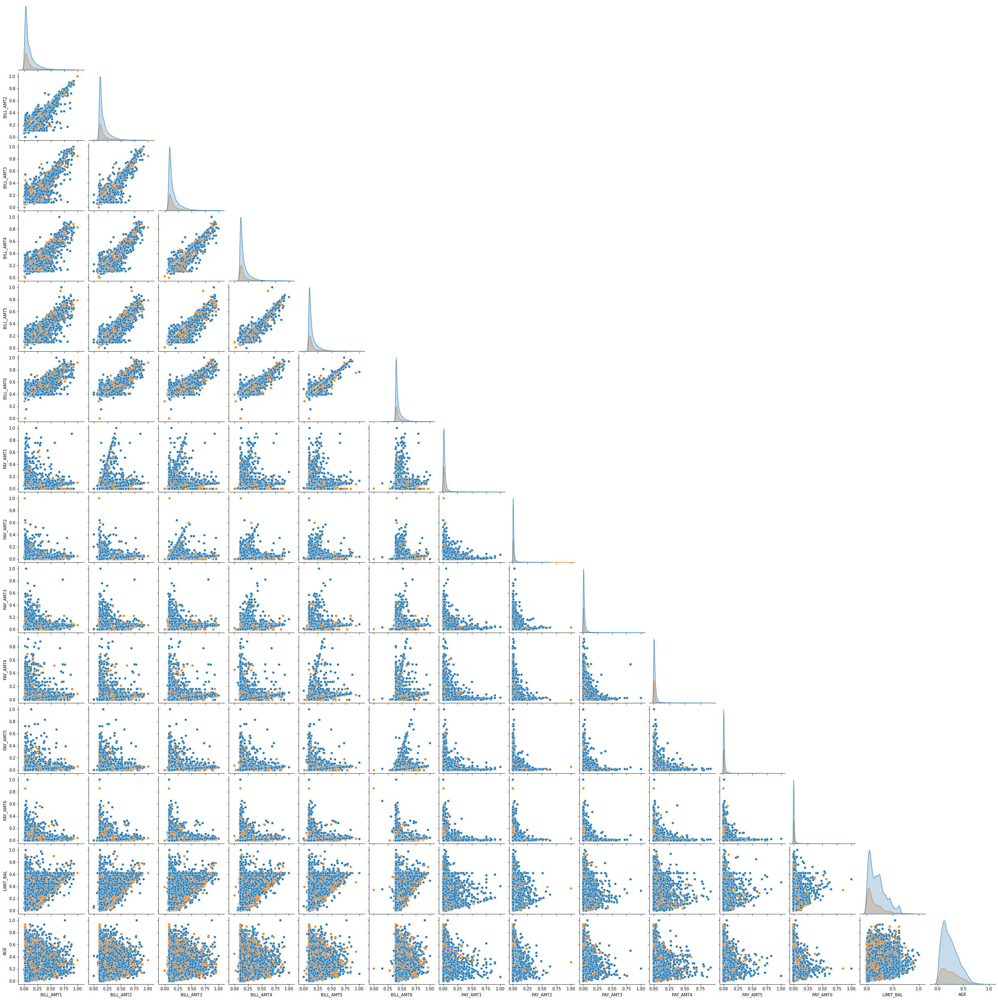

In [60]:
#d1 = ['PAY_' + str(n) for n in range(1, 7)]
d2 = ['BILL_AMT' + str(n) for n in range(1, 7)]
d3 = ['PAY_AMT' + str(n) for n in range(1, 7)]
dimensions = d2 + d3 +['LIMIT_BAL','AGE','default payment next month']
X_train['default payment next month'] = Y_train
pairpl = sns.pairplot(X_train[dimensions], hue='default payment next month', diag_kind='kde', corner=True);
pairpl._legend.remove()


X_train.drop('default payment next month', axis=1, inplace=True)

[Text(0.5, 0, 'PAY_1'),
 Text(1.5, 0, 'PAY_2'),
 Text(2.5, 0, 'PAY_3'),
 Text(3.5, 0, 'PAY_4'),
 Text(4.5, 0, 'PAY_5'),
 Text(5.5, 0, 'PAY_6'),
 Text(6.5, 0, 'BILL_AMT1'),
 Text(7.5, 0, 'BILL_AMT2'),
 Text(8.5, 0, 'BILL_AMT3'),
 Text(9.5, 0, 'BILL_AMT4'),
 Text(10.5, 0, 'BILL_AMT5'),
 Text(11.5, 0, 'BILL_AMT6'),
 Text(12.5, 0, 'PAY_AMT1'),
 Text(13.5, 0, 'PAY_AMT2'),
 Text(14.5, 0, 'PAY_AMT3'),
 Text(15.5, 0, 'PAY_AMT4'),
 Text(16.5, 0, 'PAY_AMT5'),
 Text(17.5, 0, 'PAY_AMT6'),
 Text(18.5, 0, 'LIMIT_BAL'),
 Text(19.5, 0, 'AGE')]

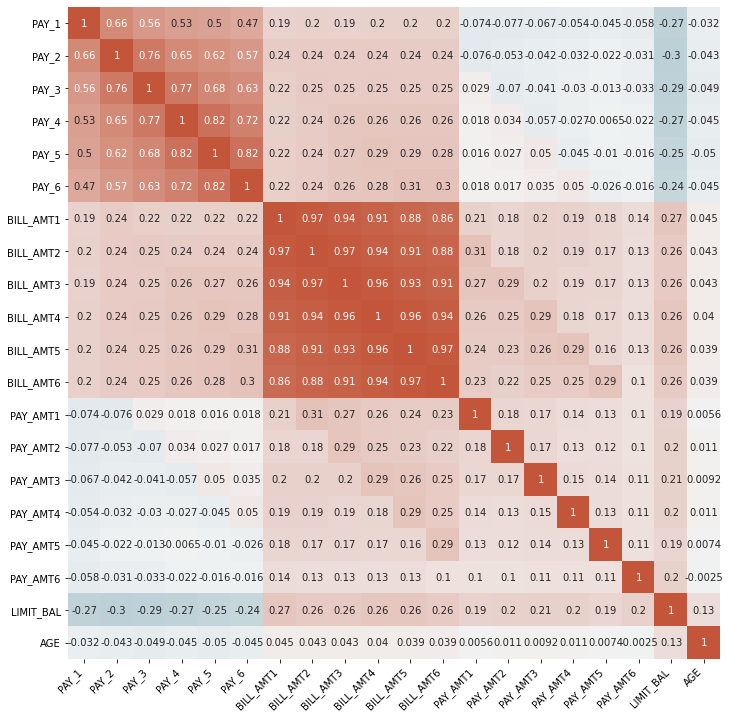

In [61]:
dimensions = ['PAY_' + str(n) for n in range(1, 7)] + dimensions
corr = X_train[dimensions[:-1]].corr()
fig, ax = plt.subplots(figsize=(12,12)) 
sns.heatmap(
    corr, 
    vmin = -1, 
    vmax = 1, 
    center = 0,
    cmap = sns.diverging_palette(220, 20, n=200),
    square = True,
    ax = ax,
    annot = True,
    cbar = False

)
ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=45,
    horizontalalignment='right'
)

As displayed in the correlation matrix, there exist an high positive correlation among the BILL_AMT features: in order to remove correlated features a Principal component analysis is performed

# Dimensionality reduction

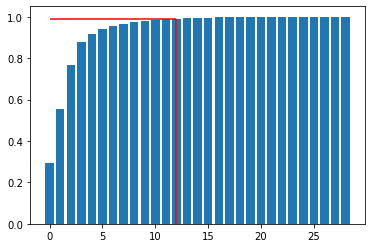

In [62]:
from sklearn.decomposition import PCA
n_dims = X_train.shape[1]
model = PCA(n_components=n_dims)
model.fit(X_train)

variances = model.explained_variance_ratio_

meilleur_dims = np.argmax(np.cumsum(variances) > 0.99)


plt.bar(range(n_dims), np.cumsum(variances))
plt.hlines(0.99, 0, meilleur_dims, colors='r')
plt.vlines(meilleur_dims, 0, 0.99, colors='r')



In [63]:
meilleur_dims

12

In [64]:
pc=meilleur_dims
pca = PCA(n_components=pc)
pca.fit(X_train)
X_train.index = pd.RangeIndex(start=0, stop=len(X_train), step=1)
X_15d_train_val = pd.DataFrame(pca.transform(X_train))
X_15d_test = pd.DataFrame(pca.transform(X_test))
X_15d_train_val.columns = ['PC' + str(i) for i in range(1, pc+1) ]
X_15d_test.columns = ['PC' + str(i) for i in range(1, pc+1) ]
X_15d_train_val.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12
0,0.620416,0.691587,-0.900449,-0.011092,0.124539,-0.347854,0.041345,-0.032713,-0.004585,0.038551,-0.165062,-0.018372
1,0.179858,-0.659717,-0.844039,-0.020094,-0.009324,-0.091325,-0.008392,-0.026394,-0.065565,0.169710,-0.157885,-0.019416
2,-0.617358,1.092927,-0.334165,-0.257615,-0.053238,-0.103774,0.020189,-0.019504,0.022899,-0.071016,0.035500,0.003752
3,0.713248,-0.802057,0.399189,-0.133016,0.448757,-0.400679,0.005571,-0.004146,-0.022593,0.034364,0.047399,0.028776
4,-0.884924,-0.284406,0.553377,0.851422,-0.188369,0.107500,0.107941,-0.159625,0.095749,0.097887,0.147578,0.040945


In [65]:
X_train_select_f,X_test_select_f,Y_train_select_f,Y_test_select_f=train_test_split(X,Y,test_size=0.2,random_state=0)

In [66]:
X_train_select_f.head()

,LIMIT_BAL,SEX_TYPE_1,SEX_TYPE_2,EDU_TYPE_1,EDU_TYPE_2,EDU_TYPE_3,EDU_TYPE_4,Mar_TYPE_1,Mar_TYPE_2,Mar_TYPE_3,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6
16521,0.012658,1,0,0,1,0,0,0,1,0,0.086207,0.4,0.5,0.4,0.2,0.2,0.4,0.045995,0.131051,0.106492,0.132347,0.120892,0.412494,0.000000,0.000000,0.008530,0.016133,0.005280,0.000000
414,0.278481,0,1,0,1,0,0,0,1,0,0.103448,0.3,0.4,0.2,0.2,0.2,0.2,0.043750,0.128264,0.105098,0.124647,0.108861,0.397467,0.000000,0.003089,0.001899,0.001683,0.003520,0.011502
6914,0.063291,1,0,0,1,0,0,1,0,0,0.310345,0.2,0.2,0.2,0.2,0.2,0.2,0.124022,0.163575,0.122338,0.143610,0.124766,0.410758,0.010611,0.005806,0.000898,0.002511,0.001760,0.010161
12724,0.075949,0,1,1,0,0,0,0,1,0,0.103448,0.3,0.4,0.4,0.4,0.4,0.4,0.126576,0.206173,0.194570,0.213233,0.196060,0.469033,0.014584,0.007258,0.011223,0.013444,0.009153,0.002478
19619,0.215190,0,1,0,0,1,0,1,0,0,0.172414,0.0,0.1,0.1,0.1,0.1,0.2,0.038756,0.119849,0.135749,0.158825,0.115459,0.419233,0.036406,0.088305,0.140831,0.072576,0.042243,0.055993


# Manage dataset imbalancing

In machine learning, it is difficult to train an effective learning model if the class distribution in a given training data set is imbalanced. The overall accuracy may be high, but when computing the accuracy separatly for each class it is possible to notice that the percentage of data points that belongs to the minority class correcly classified is lower than the one computed over the majority class. To tackle this problem one can adopt two different strategies

Oversampling the minority class


Undersampling the majority class. With the following code it is possible to verify that there is an high imbalance towords the class 0, which is present in almost the 80% of the dataset. This suggest to further adopt a tecnique in order to rebalance the classes

In [68]:
l0 = Y_train[Y_train== 0].count()
l1 = Y_train[Y_train== 1].count()
print(l0,"rows labelled with 0 :",round(l0*100/(l1+l0)),"%")
print(l1,"rows labelled with 1 :",round(l1*100/(l1+l0)),"%")

17941 rows labelled with 0 : 78 %
5158 rows labelled with 1 : 22 %


## k-means SMOTE

In [69]:
from imblearn.over_sampling import SMOTE , KMeansSMOTE

def oversample_dataset(X_train, y_train):

    print("Number of instances in the training set before the rebalancing operation: ",len(X_train))
    #oversample = SMOTE()
    oversample = KMeansSMOTE(cluster_balance_threshold=0.00001)
    X_train_smote, y_train_smote = oversample.fit_resample(X_train, y_train)

    print("Number of instances in the training set after the rebalancing operation: ",len(X_train_smote))
    
    l0 = len(y_train_smote[y_train_smote == 0])
    l1 = len(y_train_smote[y_train_smote == 1])
    
    print(l0,"rows labelled with 0 :",round(l0*100/(l1+l0)),"%")
    print(l1,"rows labelled with 1 :",round(l1*100/(l1+l0)),"%")
    return X_train_smote, y_train_smote

In [70]:
#data with no corr
    # oversample the training set only 
X_pca_obalanced, y_pca_obalanced= oversample_dataset(X_train = X_15d_train_val, y_train = Y_train)


Number of instances in the training set before the rebalancing operation:  23099
Number of instances in the training set after the rebalancing operation:  35887
17941 rows labelled with 0 : 50 %
17946 rows labelled with 1 : 50 %


In [71]:
#data with  corr
    # oversample the training set only 
X_kb_obalanced, y_kb_obalanced= oversample_dataset(X_train = X_train_select_f, y_train = Y_train_select_f)

Number of instances in the training set before the rebalancing operation:  23099
Number of instances in the training set after the rebalancing operation:  35886
17941 rows labelled with 0 : 50 %
17945 rows labelled with 1 : 50 %


# **Build a model (ANN) in tensorflow/keras**

In [72]:
import tensorflow as tf
from tensorflow import keras

In [73]:
def ANN_model(hidden1,hidden2,X_train):
    model = keras.Sequential([
        keras.layers.Dense(hidden1, input_shape=(X_train.shape[1],), activation='relu'),
        keras.layers.Dense(hidden2, activation='relu'),
        keras.layers.Dense(1, activation='sigmoid')
    ])
    model.compile(optimizer='adam',
              loss='binary_crossentropy',
              metrics=['accuracy'])
    return model

    

In [74]:
def ANN_model3(hidden1,hidden2,hidden3,X_train):
    model = keras.Sequential([
        keras.layers.Dense(hidden1, input_shape=(X_train.shape[1],), activation='relu'),
        keras.layers.Dense(hidden2, activation='relu'),
        keras.layers.Dense(hidden3, activation='relu'),
        keras.layers.Dense(1, activation='sigmoid')
    ])
    model.compile(optimizer='adam',
              loss='binary_crossentropy',
              metrics=['accuracy'])
    return model

## ANN model for pca data balanced

In [94]:
Ann_mod1=ANN_model3(10,8,5,X_pca_obalanced)
Ann_mod1.fit(X_pca_obalanced, y_pca_obalanced, epochs=80)

Epoch 1/80
1122/1122 [==============================] - 3s 2ms/step - loss: 0.5710 - accuracy: 0.7060
Epoch 2/80
1122/1122 [==============================] - 2s 2ms/step - loss: 0.5164 - accuracy: 0.7453
Epoch 3/80
1122/1122 [==============================] - 2s 2ms/step - loss: 0.5067 - accuracy: 0.7540
Epoch 4/80
1122/1122 [==============================] - 2s 2ms/step - loss: 0.5019 - accuracy: 0.7590
Epoch 5/80
1122/1122 [==============================] - 2s 2ms/step - loss: 0.4993 - accuracy: 0.7603
Epoch 6/80
1122/1122 [==============================] - 2s 2ms/step - loss: 0.4975 - accuracy: 0.7628
Epoch 7/80
1122/1122 [==============================] - 2s 2ms/step - loss: 0.4961 - accuracy: 0.7643
Epoch 8/80
1122/1122 [==============================] - 2s 2ms/step - loss: 0.4950 - accuracy: 0.7630
Epoch 9/80
1122/1122 [==============================] - 2s 2ms/step - loss: 0.4934 - accuracy: 0.7653
Epoch 10/80
1122/1122 [==============================] - 2s 2ms/step - loss: 0.493

1122/1122 [==============================] - 2s 2ms/step - loss: 0.4793 - accuracy: 0.7743


In [95]:
Ann_mod1.evaluate(X_15d_test, Y_test)

181/181 [==============================] - 1s 2ms/step - loss: 0.5676 - accuracy: 0.7160


[0.5676220655441284, 0.7160173058509827]

In [96]:
def predict_m(yp):
    y_pred = []
    for element in yp:
        if element > 0.5:
            y_pred.append(1)
        else:
            y_pred.append(0)
    return y_pred

In [97]:
yp= Ann_mod1.predict(X_15d_test)

181/181 [==============================] - 0s 1ms/step


In [98]:
y_predict=predict_m(yp)

In [99]:
from sklearn.metrics import confusion_matrix , classification_report

print(classification_report(Y_test,y_predict))

              precision    recall  f1-score   support

           0       0.85      0.77      0.81      4455
           1       0.41      0.54      0.46      1320

    accuracy                           0.72      5775
   macro avg       0.63      0.65      0.64      5775
weighted avg       0.75      0.72      0.73      5775



Text(69.0, 0.5, 'Truth')

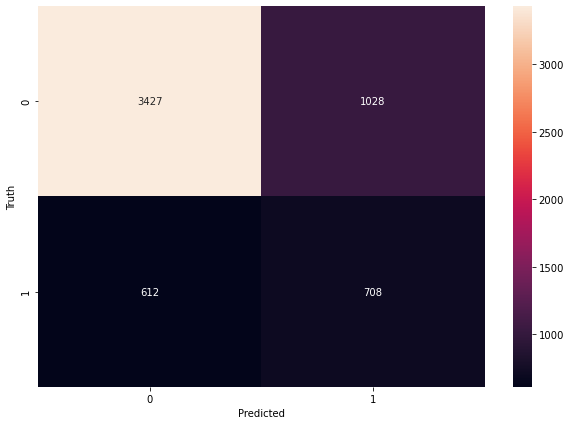

In [100]:
import seaborn as sn
cm = tf.math.confusion_matrix(labels=Y_test,predictions=y_predict)

plt.figure(figsize = (10,7))
sn.heatmap(cm, annot=True, fmt='d')
plt.xlabel('Predicted')
plt.ylabel('Truth')

### ANN model for  data balanced

In [82]:
Ann_mod1=ANN_model3(20,11,7,X_train_select_f)
Ann_mod1.fit(X_train_select_f, Y_train_select_f, epochs=80)

Epoch 1/80
722/722 [==============================] - 2s 2ms/step - loss: 0.5008 - accuracy: 0.7884
Epoch 2/80
722/722 [==============================] - 2s 2ms/step - loss: 0.4582 - accuracy: 0.8069
Epoch 3/80
722/722 [==============================] - 1s 2ms/step - loss: 0.4517 - accuracy: 0.8125
Epoch 4/80
722/722 [==============================] - 1s 2ms/step - loss: 0.4485 - accuracy: 0.8153
Epoch 5/80
722/722 [==============================] - 1s 2ms/step - loss: 0.4468 - accuracy: 0.8164
Epoch 6/80
722/722 [==============================] - 2s 2ms/step - loss: 0.4451 - accuracy: 0.8177
Epoch 7/80
722/722 [==============================] - 1s 2ms/step - loss: 0.4437 - accuracy: 0.8159
Epoch 8/80
722/722 [==============================] - 1s 2ms/step - loss: 0.4429 - accuracy: 0.8180
Epoch 9/80
722/722 [==============================] - 1s 2ms/step - loss: 0.4420 - accuracy: 0.8177
Epoch 10/80
722/722 [==============================] - 1s 2ms/step - loss: 0.4418 - accuracy: 0.8174

In [83]:
Ann_mod1.evaluate(X_test_select_f, Y_test_select_f)

181/181 [==============================] - 1s 3ms/step - loss: 0.4412 - accuracy: 0.8154


[0.44118714332580566, 0.8154112696647644]

In [84]:
y_p= Ann_mod1.predict(X_test_select_f)

181/181 [==============================] - 1s 2ms/step


In [85]:
y_predict=predict_m(y_p)

In [86]:
from sklearn.metrics import confusion_matrix , classification_report

print(classification_report(Y_test,y_predict))

              precision    recall  f1-score   support

           0       0.85      0.93      0.89      4455
           1       0.64      0.43      0.52      1320

    accuracy                           0.82      5775
   macro avg       0.75      0.68      0.70      5775
weighted avg       0.80      0.82      0.80      5775



Text(69.0, 0.5, 'Truth')

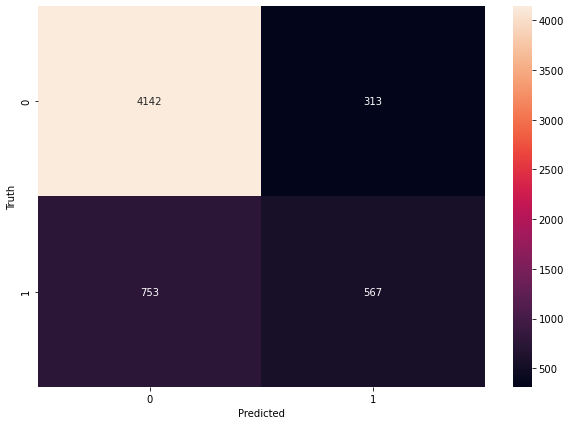

In [87]:
import seaborn as sn
cm = tf.math.confusion_matrix(labels=Y_test,predictions=y_predict)

plt.figure(figsize = (10,7))
sn.heatmap(cm, annot=True, fmt='d')
plt.xlabel('Predicted')
plt.ylabel('Truth')

 we can notice that our ann has the highest f1 score and accuracy but this ann still  can't classify the positive class

The positive class is the most difficult to classify and none of the models chosen seems to be not able to get the complexity of the problem